# Final Project

# Table of Contents
1. [Motivation](#Motivation)
   - [Dataset Overview](#Dataset-Overview)
   - [Selection Rationale](#Selection-Rationale)
   - [Goal for End User's Experience](#Goal-for-End-Users-Experience)
2. [Basic Stats](#Basic-Stats)
   - [Data Cleaning and Preprocessing](#Data-Cleaning-and-Preprocessing)
   - [Exploratory Data Analysis](#Exploratory-Data-Analysis)
3. [Data Analysis](#Data-Analysis)
   - [Analysis Insights](#Analysis-Insights)
4. [Genre and Tools](#Genre-and-Tools)
   - [Data Story Genre](#Data-Story-Genre)
   - [Visual Narrative Tools](#Visual-Narrative-Tools)
   - [Narrative Structure Tools](#Narrative-Structure-Tools)
5. [Visualizations](#Visualizations)
   - [Chosen Visualizations](#Chosen-Visualizations)
   - [Rationale Behind Visual Choices](#Rationale-Behind-Visual-Choices)
6. [Discussion](#Discussion)
   - [Project Successes](#Project-Successes)
   - [Areas for Improvement](#Areas-for-Improvement)
7. [Contributions](#Contributions)
   - [Individual Contributions](#Individual-Contributions)

## Motivation

### Dataset Overview

### Selection Rationale

### Goal for End User's Experience

## Basic Stats

### Data Cleaning and Preprocessing
In the raw listening data CSV file, the 'name' column contains composite text entries such as "Home in Copenhagen · 4.91 · 4 bedrooms · 4 beds · 1.5 baths". To better analyze and utilize this data, it is necessary to extract specific information from these entries and save them into new, dedicated columns. This will involve the use of regular expressions to separate the room type, number of bedrooms, number of beds, and number of baths from each entry. By structuring the data in this way, we can facilitate more straightforward and effective data analysis and reporting.

In [7]:
csv_file_path = '/Users/dan/DTU_PROJECT/02806 Social Data/Final/DataViz-AirBnB/Code/Processed_Data.csv'

In [10]:
import csv
import re

input_file_path = '/Users/dan/DTU_PROJECT/02806 Social Data/Final/DataViz-AirBnB/data/listings(Sept).csv'
output_file_path = 'Processed_Data.csv'

pattern = re.compile(r'(.+) · (\ \d+\.\d+) · (\d+) bedroom[s]? · (\d+) bed[s]? · ([\d.]+) ((shared|private) )?bath[s]?')

with open(input_file_path, mode='r', newline='', encoding='utf-8') as infile, \
     open(output_file_path, mode='w', newline='', encoding='utf-8') as outfile:
    reader = csv.DictReader(infile)
    fieldnames = reader.fieldnames + ['Rating', 'Bedrooms', 'Beds', 'Baths']
    writer = csv.DictWriter(outfile, fieldnames=fieldnames)
    writer.writeheader()

    for row in reader:
        match = pattern.match(row['name'])
        if match:
            row['Rating'] = match.group(2)
            row['Bedrooms'] = match.group(3)
            row['Beds'] = match.group(4)
            row['Baths'] = match.group(5)
        
        writer.writerow(row)


### Exploratory Data Analysis

Our dataset consists of various properties listed in Copenhagen, with columns providing detailed information such as the location, host details, room type, pricing, and guest reviews. A particularly complex field within our dataset is the 'name' column, which includes descriptions of properties that encompass ratings, room types, and the number of bedrooms, beds, and baths. These have been extracted and categorized separately using regular expressions to facilitate more nuanced analysis.

1. Geographical Distribution: The properties are primarily concentrated in central neighborhoods like Indre By and Vesterbro-Kongens Enghave. A scatter plot of latitude and longitude data helps visualize the density and distribution of listings, indicating higher concentrations in central areas known for tourism and commerce.
2. Room Type Analysis: The majority of listings in our dataset are categorized as "Entire home/apt," suggesting a market trend towards full-property rentals over shared spaces. Pie charts can be used to represent the proportion of each room type, providing a visual understanding of market preferences.
3. Pricing Strategy Insights: Analysis of the 'price' column shows variations in pricing strategies across different neighborhoods. A histogram of pricing data could indicate the range and common pricing points, highlighting the premium locations command higher rates.
4. Availability Trends: The 'availability_365' column, representing the number of days a property is available for booking in a year, can reveal seasonal trends in property rental. Plotting this data across months might show peak tourist seasons and off-peak times, which could assist hosts in planning their availability and pricing.


## Data Analysis

### Analysis Insights


The analysis derived from the dataset provide significant insights into the characteristics of rental listings in Copenhagen:

**Rating Distribution**: The histogram of ratings shows a highly left-skewed distribution, indicating that most listings have high ratings, with the majority clustered around the 5.0 mark. This suggests a generally positive guest experience or possibly that guests tend to leave reviews predominantly when satisfied.

**Price Distribution**: By filtering out extreme outliers (prices beyond the 99th percentile), the histogram of prices reveals a multi-modal distribution. Most of the listings are priced under 1,000, but there are noticeable peaks around 500 and then a smaller peak at around 1,500. This indicates varying levels of accommodation quality and could suggest different market segments, from budget to premium offerings.

**Rating vs. Price**: The scatter plot exploring the relationship between ratings and prices does not show a clear correlation, as higher prices do not necessarily equate to higher ratings. This suggests that guests value other factors as much as, or possibly more than, price when assessing their satisfaction.

These insights can help property managers and hosts in Copenhagen understand the competitive landscape of their market, focusing on maintaining high ratings which are crucial for attracting bookings, regardless of the price segment they are targeting. It also highlights the importance of managing guest expectations, where even higher-priced listings must ensure service and quality justify their pricing to maintain high ratings.

count    12929.000000
mean         4.815554
std          0.234387
min          0.000000
25%          4.730000
50%          4.880000
75%          5.000000
max          5.000000
Name: Rating, dtype: float64


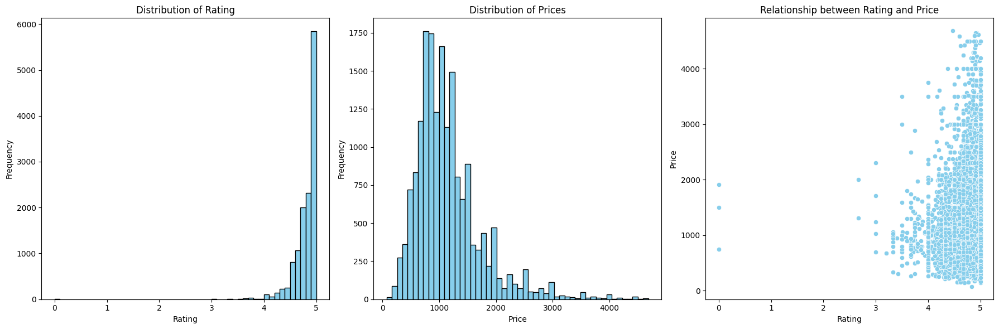

In [11]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns  

df = pd.read_csv(csv_file_path)

print(df['Rating'].describe())


fig, axs = plt.subplots(1, 3, figsize=(18, 6))


axs[0].hist(df['Rating'], bins=50, color='skyblue', edgecolor='black')
axs[0].set_xlabel('Rating')
axs[0].set_ylabel('Frequency')
axs[0].set_title('Distribution of Rating')


q99 = df['price'].quantile(0.99)
df_filtered = df[df['price'] <= q99]
axs[1].hist(df_filtered['price'], bins=50, color='skyblue', edgecolor='black')
axs[1].set_xlabel('Price')
axs[1].set_ylabel('Frequency')
axs[1].set_title('Distribution of Prices')


sns.scatterplot(data=df_filtered, x='Rating', y='price', ax=axs[2], color='skyblue')


axs[2].set_xlabel('Rating')
axs[2].set_ylabel('Price')
axs[2].set_title('Relationship between Rating and Price')


plt.tight_layout()

plt.show()


The results from the Ordinary Least Squares (OLS) regression analysis, which aimed to explore the relationship between ratings and price, indicate a statistically insignificant impact of ratings on the pricing of listings. The regression coefficient for the rating is 72.9135 with a p-value of 0.271, suggesting that changes in rating do not reliably predict changes in price in a statistically significant manner.

In [12]:
import pandas as pd
import statsmodels.api as sm

df = pd.read_csv(csv_file_path)

df_clean = df.dropna(subset=['Rating', 'price'])


if len(df_clean) < len(df):
    print("Removed", len(df) - len(df_clean), "rows with NaN values.")


X = df_clean['Rating']  
y = df_clean['price']  

# Add constant terms to the independent variables
X = sm.add_constant(X)

# Create linear regression models
model = sm.OLS(y, X)

# Fitting models
results = model.fit()


print(results.summary())




Removed 5197 rows with NaN values.
                            OLS Regression Results                            
Dep. Variable:                  price   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                  0.000
Method:                 Least Squares   F-statistic:                     1.212
Date:                Tue, 30 Apr 2024   Prob (F-statistic):              0.271
Time:                        21:26:01   Log-Likelihood:            -1.1500e+05
No. Observations:               12929   AIC:                         2.300e+05
Df Residuals:                   12927   BIC:                         2.300e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const        865.

The analysis depict the distribution of various characteristics of rental properties, such as the number of bedrooms, beds, baths, and the type of room offered. Key observations include:

1. Bedroom Distribution: The majority of properties have one bedroom (59%), followed by two bedrooms (24.8%). Properties with three and four bedrooms are less common, making up 12% and 3.4% respectively. This suggests a prevalence of smaller accommodations, likely catering to solo travelers or small groups.

2. Bed Distribution: Half of the properties offer two beds (50.3%), indicating these listings may cater primarily to couples or small families. One-bed configurations are also popular (25.5%), ideal for solo travelers or couples without children.
3. Bath Distribution: A significant majority of properties (87.2%) have just one bathroom, highlighting a standard setup in rental listings, which likely meets the needs of most small travel parties.
4. Room Type Distribution: The overwhelming majority of listings are entire homes or apartments (90.3%), suggesting a strong market preference for privacy and full-property rentals over shared spaces. Only a small fraction of listings are private rooms (9.5%), emphasizing the minor role of shared accommodation in this market.
These distributions provide valuable insights into market trends and preferences in rental properties, which can aid property managers and hosts in optimizing their offerings to align with the most common and demanded property features.

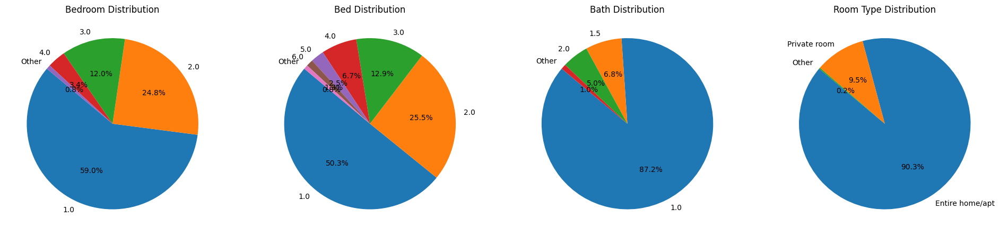

In [13]:

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt


data = pd.read_csv(csv_file_path)
df = data.dropna(subset=['Bedrooms', 'Beds', 'Baths'])
np.random.seed(0)

# Function to consolidate small categories into 'Other'
def consolidate_categories(series, threshold=0.01):
    counts = series.value_counts(normalize=True)
    others = counts[counts < threshold].index
    series = series.apply(lambda x: 'Other' if x in others else x)
    return series.value_counts(normalize=True)

# Calculating frequency for each category
bedroom_counts = consolidate_categories(df['Bedrooms'])
bed_counts = consolidate_categories(df['Beds'])
bath_counts = consolidate_categories(df['Baths'])
room_type_counts = consolidate_categories(df['room_type'])

# Plotting pie charts
fig, axs = plt.subplots(1, 4, figsize=(24, 8))

labels = [bedroom_counts.index, bed_counts.index, bath_counts.index, room_type_counts.index]
data = [bedroom_counts, bed_counts, bath_counts, room_type_counts]
titles = ['Bedroom Distribution', 'Bed Distribution', 'Bath Distribution', 'Room Type Distribution']

for ax, count, label, title in zip(axs, data, labels, titles):
    ax.pie(count, labels=label, autopct='%1.1f%%', startangle=140)
    ax.set_title(title)

plt.show()

The bar charts provide a clear overview of the distribution characteristics for bedrooms, beds, baths, and room types in rental listings:

1. Bedrooms: The distribution is heavily skewed towards listings with fewer bedrooms. Most listings feature one bedroom, with two-bedroom properties also representing a significant portion of the market. Listings with more than three bedrooms are increasingly rare, which suggests that the rental market caters predominantly to individuals or small groups.

2. Beds: Similar to bedrooms, the number of beds in properties also shows a skew towards fewer numbers. Single-bed setups are the most common, followed by two-bed arrangements. The prevalence of one and two beds aligns with the typical needs of solo travelers and small families or groups.

3. Baths: Over 80% of the listings have just one bathroom, indicating a standard setup across rental properties. Listings with more than one bathroom are relatively uncommon, which may reflect the urban space constraints or the target market of solo travelers and small groups who do not require multiple bathrooms.

4. Room Types: The overwhelming majority of listings are for entire homes or apartments, indicating a strong market preference for privacy and complete spaces. Private rooms make up a smaller fraction of the market, and shared rooms are minimal, suggesting that shared accommodations are much less popular among renters.
These distributions can help stakeholders in the rental market understand current trends and adjust their offerings to better meet the demand. They also provide potential renters with an understanding of what types of properties are most readily available.

In [14]:
from bokeh.plotting import figure, show, output_file
from bokeh.models import ColumnDataSource, HoverTool, TapTool
from bokeh.layouts import column
from bokeh.io import output_notebook
import pandas as pd
import numpy as np
from bokeh.layouts import gridplot


data = pd.read_csv(csv_file_path)
df = data.dropna(subset=['Bedrooms', 'Beds', 'Baths'])


bedroom_counts = df['Bedrooms'].value_counts(normalize=True).sort_index()
bed_counts = df['Beds'].value_counts(normalize=True).sort_index()
bath_counts = df['Baths'].value_counts(normalize=True).sort_index()
room_type_counts = df['room_type'].value_counts(normalize=True).sort_index()


sources = {
    'Bedrooms': ColumnDataSource(data=dict(values=bedroom_counts.values, categories=bedroom_counts.index.astype(str))),
    'Beds': ColumnDataSource(data=dict(values=bed_counts.values, categories=bed_counts.index.astype(str))),
    'Baths': ColumnDataSource(data=dict(values=bath_counts.values, categories=bath_counts.index.astype(str))),
    'Room Types': ColumnDataSource(data=dict(values=room_type_counts.values, categories=room_type_counts.index.astype(str)))
}


output_notebook()  

def create_vbar_chart(source, title):
    categories = [str(x) for x in source.data['categories']]
    p = figure(x_range=categories, height=300, title=title,
               toolbar_location=None, tools="tap")
    p.vbar(x='categories', top='values', width=0.9, source=source, color="navy", selection_color="firebrick")
    

    hover = HoverTool()
    hover.tooltips = [
        ("Category", "@categories"),
        ("Value", "@values{0.00%}")  
    ]
    p.add_tools(hover)
    
    return p



figs = [create_vbar_chart(sources[name], name) for name in ['Bedrooms', 'Beds', 'Baths', 'Room Types']]


grid = gridplot([[figs[0], figs[1]], [figs[2], figs[3]]])


show(grid)


Loading BokehJS ...

The bar chart illustrates the availability distribution of rental listings over the year, categorized into various ranges of days. The highest concentration of listings is available for less than 36 days per year, indicating a large number of properties are either rarely available or primarily used by the owners for most of the year. This could reflect a strategic management of availability to comply with local regulations or to maximize occupancy during peak demand periods.

The distribution then shows fewer listings as the availability range increases, with slight increases again in the ranges of 292-328 days and over 328 days. These latter categories likely represent properties that are almost exclusively used for rental purposes, available nearly year-round.

This data is useful for understanding seasonal rental trends and could help prospective renters identify times when more properties might be available. It also helps property managers strategize their listing's availability to optimize occupancy and comply with local housing laws.

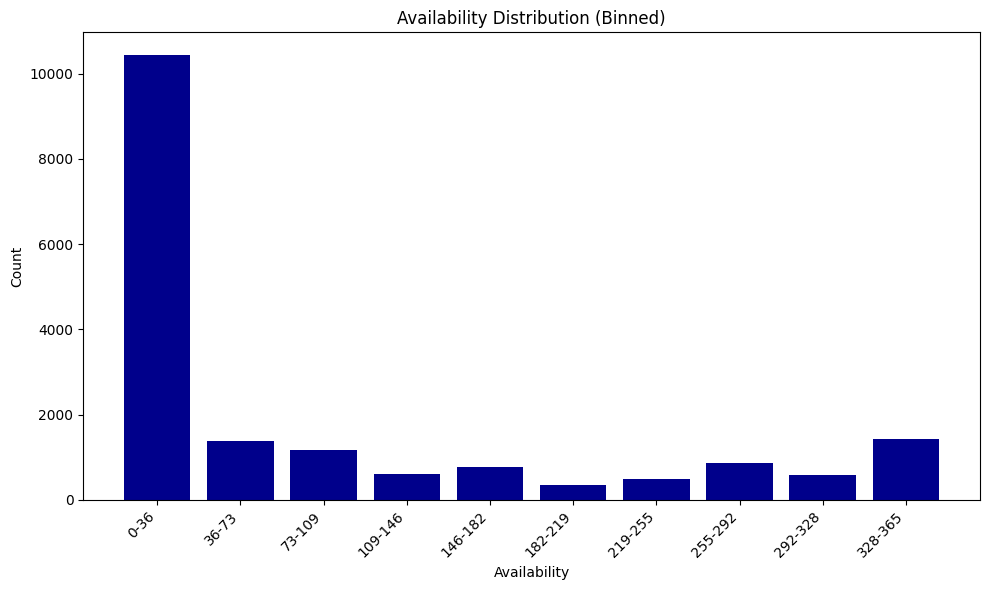

In [15]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

data = pd.read_csv(csv_file_path)
availability_365 = data['availability_365']


num_bins = 10


bins = np.linspace(min(availability_365), max(availability_365), num_bins + 1)
bin_labels = [f'{int(bins[i])}-{int(bins[i+1])}' for i in range(len(bins)-1)]
availability_groups = pd.cut(availability_365, bins=bins, labels=bin_labels, include_lowest=True)


counts = availability_groups.value_counts().sort_index()


plt.figure(figsize=(10, 6))
plt.bar(counts.index, counts, color='darkblue')


plt.title('Availability Distribution (Binned)')
plt.xlabel('Availability')
plt.ylabel('Count')


plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()


## Genre and Tools

### Data Story Genre

### Visual Narrative Tools

### Narrative Structure Tools

## Visualizations

### Chosen Visualizations

The image illustrates a geographic visualization, represented through a heatmap or bar graph overlay on a map of the greater Copenhagen area, showcasing the density and distribution of various property listings. The red bars likely indicate higher concentrations of available properties, whereas the yellow bars represent areas with fewer listings.

This visualization effectively highlights the areas with the most significant rental activity, centralizing around Copenhagen's urban centers such as Kongens Lyngby and the vicinity of the airport in Kastrup. Such data is crucial for understanding market dynamics, including where demand for rental properties is highest or where more accommodation options are needed. It also aids potential renters in identifying where they might find more options for housing, and can assist property managers and developers in targeting their investments and marketing efforts to areas with high activity levels or underserved markets.

In [4]:
import pydeck as pdk
import pandas as pd
csv_file_path = '/Users/dan/DTU_PROJECT/02806 Social Data/Final/DataViz-AirBnB/data/listings(Sept).csv'  
data = pd.read_csv(csv_file_path)
# Define the HexagonLayer
hexagon_layer = pdk.Layer(
    "HexagonLayer",
    data,
    get_position="[longitude, latitude]",
    auto_highlight=True,
    elevation_scale=25,
    pickable=True,
    elevation_range=[0, 600],
    extruded=True,
    coverage=0.3
)

# Set the viewport location
view_state = pdk.ViewState(
    latitude=data['latitude'].mean(),
    longitude=data['longitude'].mean(),
    zoom=10,
    bearing=0,
    pitch=40
)

# Render the deck.gl map
r = pdk.Deck(layers=[hexagon_layer], initial_view_state=view_state)
r.to_html('hexagon_layer.html')

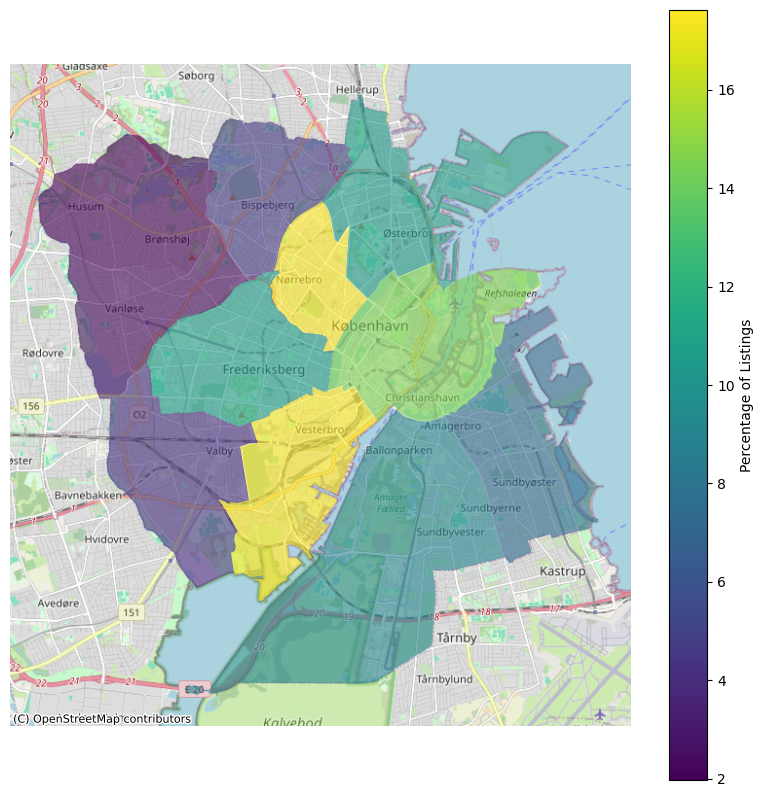

In [17]:

import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as ctx

def calculate_neighbourhood_percentages(data):
    neighbourhoods_data = data['neighbourhood']
    neighbourhoods_counts = neighbourhoods_data.value_counts()
    neighbourhoods_counts_normalized = (neighbourhoods_counts / neighbourhoods_counts.sum()) * 100
    return pd.DataFrame({
        'neighbourhood': neighbourhoods_counts_normalized.index,
        'Percentage': neighbourhoods_counts_normalized.values
    })

def plot_neighbourhood_data(neighbourhood_percentages, geo_data):
    geo_data = geo_data.set_index('neighbourhood').join(neighbourhood_percentages.set_index('neighbourhood'))
    # Converting data to Web Mercator projection, which is required to add tile maps
    geo_data = geo_data.to_crs(epsg=3857)
    
    fig, ax = plt.subplots(1, 1, figsize=(10, 10))
    # Decrease the transparency of the fill color and increase the alpha value
    geo_data.plot(column='Percentage', ax=ax, legend=True,
                  legend_kwds={'label': "Percentage of Listings"},
                  alpha=0.6)  #The alpha parameter controls fill transparency.
    
    # Add tile maps as background
    ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)
    ax.set_axis_off()  # 关闭轴显示
    plt.show()


data = pd.read_csv(csv_file_path)
geo_data = gpd.read_file('/Users/dan/DTU_PROJECT/02806 Social Data/Final/DataViz-AirBnB/data/neighbourhoods.geojson')  # 替换为你的街区边界GeoJSON文件路径


neighbourhood_percentages = calculate_neighbourhood_percentages(data)

plot_neighbourhood_data(neighbourhood_percentages, geo_data)

### Rationale Behind Visual Choices

## Discussion

### Project Successes

### Areas for Improvement

## Contributions

### Individual Contributions